Analysis on Medicare Data
===

## Technical Interview Task, by Gina Kim

## Introduction

In this analysis, I will use **Medicare dataset** from Google Cloud Platform to draw insights on outpatients services in the United States from 2011 to 2014. 


**Data Source**

- https://console.cloud.google.com/marketplace/product/hhs/medicare?q=search&referrer=search&supportedpurview=project

This public dataset was created by the Centers for Medicare & Medicaid Services. The data summarizes utilization and payments for procedures, services, and prescription drugs provided to Medicare beneficiaries by specific inpatient and outpatient hospitals, physicians, and other suppliers. The dataset includes the following data - common inpatient and outpatient services, all physician and other supplier procedures and services, and all Part D prescriptions.

In this analysis, 4 datasets were used in total: 
- outpatient_charges_2011, 43,372 Rows 
- outpatient_charges_2012, 43,783 Rows
- outpatient_charges_2013, 42,843 Rows
- outpatient_charges_2014, 35,895 Rows

## Importing Data

In [65]:
# Google Cloud API

from google.oauth2 import service_account
from google.cloud import bigquery

In [66]:
# Importing Libraries for data frames and visualisation

import pandas as pd
import numpy as np
pd.set_option("display.max_columns", None)
import matplotlib.pyplot as plt
import seaborn as sns

In [67]:
# Calling big query, here I am using my credentials saved on local drive

key = "/Users/macbook/Documents/VS Studio/Data Science Project-5063d61d335b.json" #Please insert your credentials

credentials = service_account.Credentials.from_service_account_file(key, scopes=["https://www.googleapis.com/auth/cloud-platform"],
)
client = bigquery.Client(
    credentials=credentials,
    project = credentials.project_id,
)

In [68]:
# Importing Medicare datasets from the Google Cloud and into Pandas data frames

medicare_dataset = client.dataset("medicare", project="bigquery-public-data")
columns = [x.table_id for x in client.list_tables(medicare_dataset)]
print(columns)

['inpatient_charges_2011', 'inpatient_charges_2012', 'inpatient_charges_2013', 'inpatient_charges_2014', 'outpatient_charges_2011', 'outpatient_charges_2012', 'outpatient_charges_2013', 'outpatient_charges_2014', 'part_d_prescriber_2014', 'physicians_and_other_supplier_2012', 'physicians_and_other_supplier_2013', 'physicians_and_other_supplier_2014']


In [69]:
outpatient2011 = client.list_rows(client.get_table(medicare_dataset.table('outpatient_charges_2011'))).to_dataframe()
outpatient2012 = client.list_rows(client.get_table(medicare_dataset.table('outpatient_charges_2012'))).to_dataframe()
outpatient2013 = client.list_rows(client.get_table(medicare_dataset.table('outpatient_charges_2013'))).to_dataframe()
outpatient2014 = client.list_rows(client.get_table(medicare_dataset.table('outpatient_charges_2014'))).to_dataframe()

## Observing & Checking Data for Cleaning

In [70]:
#Observing the head of outpatient2011 data frame, noting down the two important columns - 'apc', 'outpatient_services', 'provider_city' and 'average_total_payments'. 

outpatient2011.head()

,apc,provider_id,provider_name,provider_street_address,provider_city,provider_state,provider_zipcode,hospital_referral_region,outpatient_services,average_estimated_submitted_charges,average_total_payments
0,0607 - Level 4 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,243,276.285926,145.296132
1,0605 - Level 2 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,5101,108.145226,86.489831
2,0606 - Level 3 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,948,153.816709,115.100000
3,"0209 - Level II Extended EEG, Sleep, and Cardi...",20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,275,3928.275527,885.646618
4,0096 - Level II Noninvasive Physiologic Studies,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,20,688.400000,118.901500


In [71]:
# Checking the column names and data types across all data frames, confirming that the columns 'apc', 'outpatient_services', 'average_total_payments', and 'provider_city' have consistent names and data types in all 4 files.

print(outpatient2011.dtypes)
print(outpatient2012.dtypes)
print(outpatient2013.dtypes)
print(outpatient2014.dtypes)

apc                                     object
provider_id                              int64
provider_name                           object
provider_street_address                 object
provider_city                           object
provider_state                          object
provider_zipcode                         int64
hospital_referral_region                object
outpatient_services                      int64
average_estimated_submitted_charges    float64
average_total_payments                 float64
dtype: object
apc                                     object
provider_id                              int64
provider_name                           object
provider_street_address                 object
provider_city                           object
provider_state                          object
provider_zipcode                         int64
hospital_referral_region                object
outpatient_services                      int64
average_estimated_submitted_charges    float64

In [72]:
#Concatenating 4 datasets into one data frame, extracting 4 important columns from the data frame.

outpatient_all = [outpatient2011, outpatient2012, outpatient2013, outpatient2014]
df = pd.concat(outpatient_all)
df.head()

,apc,provider_id,provider_name,provider_street_address,provider_city,provider_state,provider_zipcode,hospital_referral_region,outpatient_services,average_estimated_submitted_charges,average_total_payments
0,0607 - Level 4 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,243,276.285926,145.296132
1,0605 - Level 2 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,5101,108.145226,86.489831
2,0606 - Level 3 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,948,153.816709,115.100000
3,"0209 - Level II Extended EEG, Sleep, and Cardi...",20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,275,3928.275527,885.646618
4,0096 - Level II Noninvasive Physiologic Studies,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,20,688.400000,118.901500


In [73]:
#Checking if there is any null values in the dataframe.
df.isnull().sum() 

apc                                    0
provider_id                            0
provider_name                          0
provider_street_address                0
provider_city                          0
provider_state                         0
provider_zipcode                       0
hospital_referral_region               0
outpatient_services                    0
average_estimated_submitted_charges    0
average_total_payments                 0
dtype: int64

1.1. The most common outpatient diagnostic conditions in the United States
==

In [74]:
df1 = df[['apc','outpatient_services']]
df1 = df1.groupby(['apc']).sum()
df1 = df1.sort_values(by=['outpatient_services'], ascending = False)
df1.head()

,outpatient_services
apc,
0605 - Level 2 Hospital Clinic Visits,26035007
0634 - Hospital Clinic Visits,22888446
0604 - Level 1 Hospital Clinic Visits,12929787
0606 - Level 3 Hospital Clinic Visits,10042531
0269 - Level II Echocardiogram Without Contrast,5995079


Text(0, 0.5, 'Number of Services')

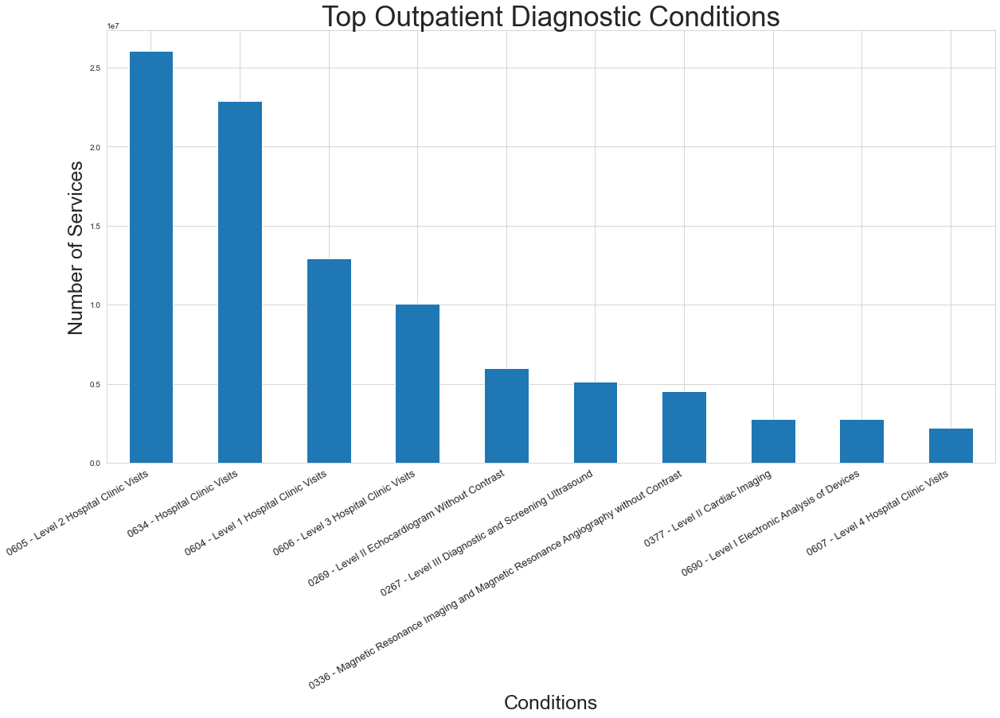

In [75]:
top_apc_df = df1.nlargest(10, ['outpatient_services']) 
top_apc_bar = top_apc_df['outpatient_services'].plot(kind='bar', figsize = (20,10))
plt.title("Top Outpatient Diagnostic Conditions", fontsize = 35)
plt.xticks(rotation=30, horizontalalignment="right", fontsize = 13)
plt.xlabel("Conditions", fontsize = 25)
plt.ylabel("Number of Services", fontsize = 25)

1.2. Cities with the most number of cases for each diagnostic condition
===

In [76]:
#Creating city_df data frame that stores 'apc', 'provider_city' and 'outpatient_services'. 

df2 = df[['apc','provider_city','outpatient_services']]
df2 = df2.groupby(['apc','provider_city']).sum()
df2 = df2.sort_values(by=['apc','outpatient_services'], ascending = [True, False])
df2 = df2.groupby(level=0).head(1)
df2 = df2.sort_values(by=['outpatient_services'], ascending = False)
df2.reset_index(inplace=True)
df2 = df2.rename(columns={'outpatient_services': 'outpatient_services_in_top_city'})

df2.head()

,apc,provider_city,outpatient_services_in_top_city
0,0604 - Level 1 Hospital Clinic Visits,CLEVELAND,781720
1,0605 - Level 2 Hospital Clinic Visits,BOSTON,630869
2,0634 - Hospital Clinic Visits,BOSTON,567603
3,0606 - Level 3 Hospital Clinic Visits,BOSTON,403696
4,0607 - Level 4 Hospital Clinic Visits,BOSTON,119158


In [77]:
#The data is now sorted by descending order of the 'outpatient_services_in_top_city'. This order is slightly different from df1. I will merge this data with df1, with df1 being left (and therefore in correct order) and assign it to df2.

df1.reset_index(inplace=True)
df2 = pd.merge(df1, df2, on="apc")
df2 = df2.set_index('apc')
df2.head()

,outpatient_services,provider_city,outpatient_services_in_top_city
apc,,,
0605 - Level 2 Hospital Clinic Visits,26035007,BOSTON,630869
0634 - Hospital Clinic Visits,22888446,BOSTON,567603
0604 - Level 1 Hospital Clinic Visits,12929787,CLEVELAND,781720
0606 - Level 3 Hospital Clinic Visits,10042531,BOSTON,403696
0269 - Level II Echocardiogram Without Contrast,5995079,CHICAGO,69166


Text(0, 0.5, 'Number of Services')

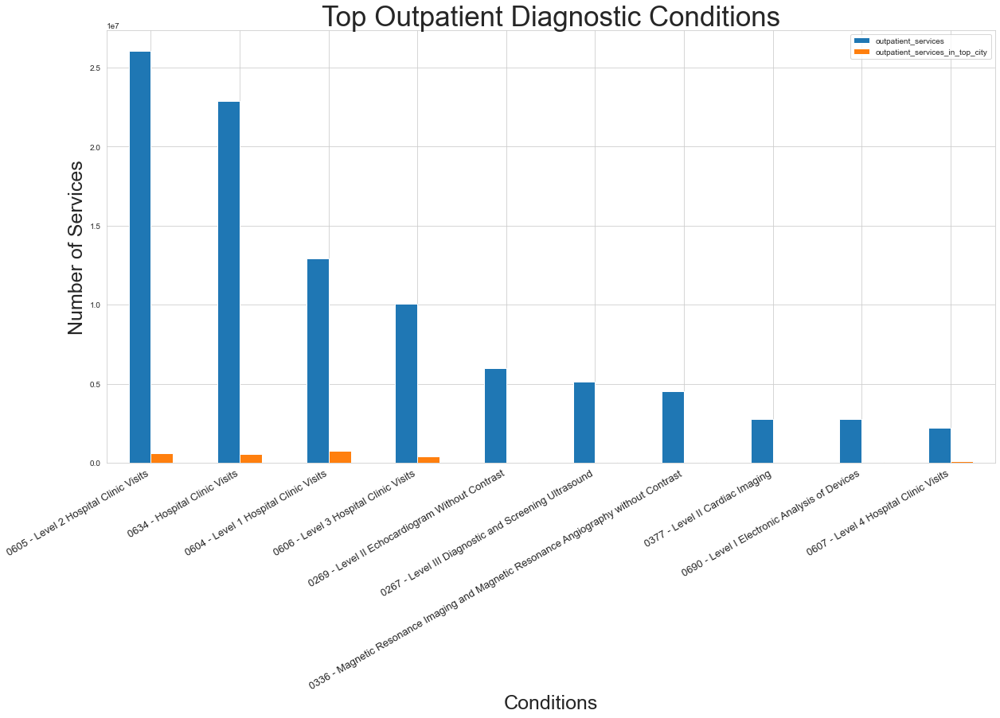

In [78]:
top_city_df = df2.nlargest(10, ['outpatient_services']) 
top_city_df = top_city_df[['outpatient_services','outpatient_services_in_top_city']]
top_city_bar = top_city_df.plot(kind='bar', figsize = (20,10))
plt.title("Top Outpatient Diagnostic Conditions", fontsize = 35)
plt.xticks(rotation=30, horizontalalignment="right", fontsize = 13)
plt.xlabel("Conditions", fontsize = 25)
plt.ylabel("Number of Services", fontsize = 25)

1.3. Average pay for these cities and comparison against the national average
==

In [79]:
df3 = df[['apc','provider_city','average_total_payments']]
df3 = df3.groupby(['apc','provider_city']).mean()
df3 = df3.rename(columns={'average_total_payments': 'average_payment_per_city'})
df3.reset_index(inplace=True)

df3 = pd.merge(df2, df3, on=["apc","provider_city"])

df3.head()

,apc,outpatient_services,provider_city,outpatient_services_in_top_city,average_payment_per_city
0,0605 - Level 2 Hospital Clinic Visits,26035007,BOSTON,630869,85.792937
1,0634 - Hospital Clinic Visits,22888446,BOSTON,567603,107.810241
2,0604 - Level 1 Hospital Clinic Visits,12929787,CLEVELAND,781720,49.342217
3,0606 - Level 3 Hospital Clinic Visits,10042531,BOSTON,403696,113.575008
4,0269 - Level II Echocardiogram Without Contrast,5995079,CHICAGO,69166,413.003440


In [80]:
df_national_avg = df[['apc','average_total_payments']]
df_national_avg = df_national_avg.groupby(['apc']).mean()

df_national_avg = df_national_avg.rename(columns={'average_total_payments': 'average_national_payments'})
df_national_avg.reset_index(inplace=True)

df_national_avg.head()

,apc,average_national_payments
0,0012 - Level I Debridement & Destruction,28.399810
1,0013 - Level II Debridement & Destruction,63.028325
2,0015 - Level III Debridement & Destruction,109.791112
3,0017 - Level V Debridement & Destruction,1585.938682
4,0019 - Level I Excision/ Biopsy,311.187346


In [81]:
df3 = pd.merge(df3, df_national_avg, on=["apc"])
df3.head()

,apc,outpatient_services,provider_city,outpatient_services_in_top_city,average_payment_per_city,average_national_payments
0,0605 - Level 2 Hospital Clinic Visits,26035007,BOSTON,630869,85.792937,74.024177
1,0634 - Hospital Clinic Visits,22888446,BOSTON,567603,107.810241,91.066808
2,0604 - Level 1 Hospital Clinic Visits,12929787,CLEVELAND,781720,49.342217,52.605434
3,0606 - Level 3 Hospital Clinic Visits,10042531,BOSTON,403696,113.575008,97.874107
4,0269 - Level II Echocardiogram Without Contrast,5995079,CHICAGO,69166,413.003440,398.271274


Text(0, 0.5, 'Average Payments')

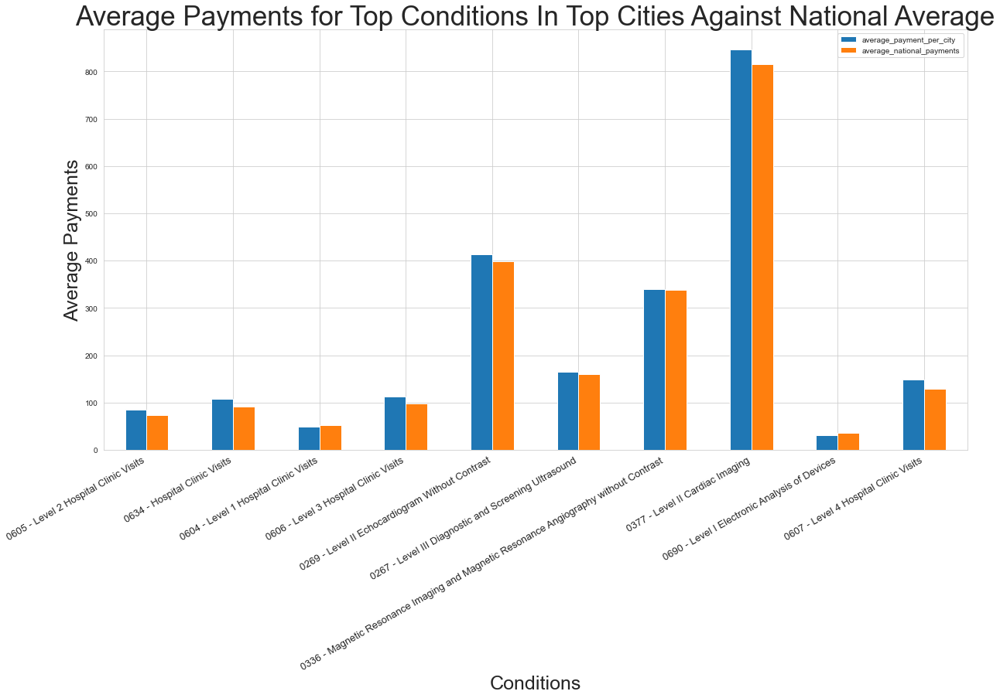

In [82]:
top_payment_df = df3.nlargest(10, ['outpatient_services']) 
top_payment_df = top_payment_df[['apc','average_payment_per_city','average_national_payments']]
top_payment_df = top_payment_df.set_index('apc')

top_payment_bar = top_payment_df.plot(kind='bar', figsize = (20,10))
plt.title("Average Payments for Top Conditions In Top Cities Against National Average", fontsize = 35)
plt.xticks(rotation=30, horizontalalignment="right", fontsize = 13)
plt.xlabel("Conditions", fontsize = 25)
plt.ylabel("Average Payments", fontsize = 25)

## Improvement

Having examined the bar chart, it looks like the top 10 outpatient services are dominated by _'Hospital Clinic Visits'_. In order to re-look at the data excluding this particular category, please duplicate this notebook and re-run the analysis by inserting this line of code after initial assignment of dataframe 'df' : 

** df = df[df.apc.str.contains("Hospital Clinic") == False] **



2.Clustering Algorithm, taking into account changes over the years. 
==



## __Introduction__ 

The **Objective**  is to create a clustering algorithm on the Medicare data - outpatient services, focusing on the amount of payments changed over the years between 2011 and 2014. 

Using clustering algorithm will help to find patterns in Medicare data. Clustering is the most well-known unsupervised learning technique. It finds structure in unlabelled data by identifying similar groups, or clusters. 

The **Desired Outcome** of this analysis are groups of data identified and clustered into groups, that share similar characteristics and more importantly similar trends of change in outpatient services payments over time. 

For example: 2 clusters identified, one representing 'normal' or average payment trends, while another cluster represents a group of outpatient services that are unusually inexpensive, or more expensive. 


## __Available Data Points__ 

For outpatient services, the following data are available. 

- **apc**: descriptions of diagnostic conditions.

- **provider_id**: unique ID for service providers(hospitals).

- **provider_name**: names of service providers.

- **provider_street_address**: address of service providers.

- **provider_city**: name of the city where the providers are located.

- **provider_state**: name of the state where the providers are located. 

- **provider_zipcode**: zip codes for the providers.

- **hospital_referral_region**: name of the region from where the hospital was referred from.

- **outpatient_services**: number of outpatient services carried out by the hospitals on a given diagnostic condition.

- **average_estimated_submitted_charges**: average estimated charges for the services carried out by the hospitals on a given diagnostic condition.

- **average_total_payments**: average total payments for the services carried out by the hospitals on a given diagnostic condition.



- And **year**: although these were collected as data points as the datasets were originally stored in 4 separate files covering the years 2011 - 2014, I have stored this into a separate column. 


## __Variables to Consider__

Columns for categorical variables such as provider_name, provider_street_address, provider_city etc will be cleaned out from this dataset.

To identify trends over time, **year** is the most important parameters here. This will be taken from the data set names.

Other useful continuous variables are **outpatient_services** which tells us the total number of services carried out by the hospitals and **average_total_payments**, which is the trend that we need to track. 

## Data Manipulation & Cleaning

There are two main continuous variables, which are average_total_payments and outpatient services. 'Year' is also a continuous variable, but only has 4 values in this case - 2011, 2012, 2013, and 2014. 

In [83]:
# Creating a new data frame for clustering analysis, taking 'year' values as index according to the file names

df4 = pd.concat(outpatient_all, keys=["2011","2012","2013","2014"])

df4.reset_index(inplace=True)
df4 = df4.rename(columns={'level_0': 'year'})
df4.drop('level_1', axis=1, inplace=True)

df4.head()

,year,apc,provider_id,provider_name,provider_street_address,provider_city,provider_state,provider_zipcode,hospital_referral_region,outpatient_services,average_estimated_submitted_charges,average_total_payments
0,2011,0607 - Level 4 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,243,276.285926,145.296132
1,2011,0605 - Level 2 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,5101,108.145226,86.489831
2,2011,0606 - Level 3 Hospital Clinic Visits,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,948,153.816709,115.100000
3,2011,"0209 - Level II Extended EEG, Sleep, and Cardi...",20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,275,3928.275527,885.646618
4,2011,0096 - Level II Noninvasive Physiologic Studies,20001,PROVIDENCE ALASKA MEDICAL CENTER,BOX 196604,ANCHORAGE,AK,99519,AK - Anchorage,20,688.400000,118.901500


In [84]:
#defining df5 to only contain continuous variables

df5 = df4[['year','average_total_payments','outpatient_services']]
df5.head()

,year,average_total_payments,outpatient_services
0,2011,145.296132,243
1,2011,86.489831,5101
2,2011,115.100000,948
3,2011,885.646618,275
4,2011,118.901500,20


In [85]:
# Checking data type

df5.dtypes

year                       object
average_total_payments    float64
outpatient_services         int64
dtype: object

In [86]:
# Changing data type of Year to INT

df5["year"] = df5["year"].astype(int)

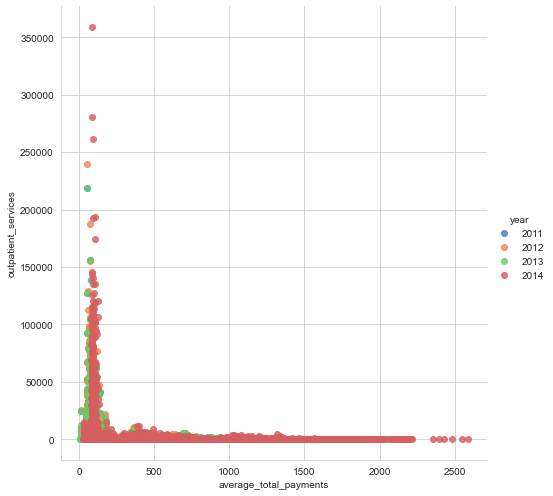

In [87]:
# Observing distribution of variables 'average total payments' and 'outpatient_services' by plotting a scatter graph

sns.set_style('whitegrid')
sns.lmplot('average_total_payments','outpatient_services',data=df5, hue='year', palette='muted', size=7, aspect=1, fit_reg=False)

## __Methodology & Algorithms__ 

Clustering is the most well-known unsupervised learning technique. It finds structure in unlabelled data by identifying similar groups, or clusters. 

I will be using K-Means algorithms as this method has many advantages, it's not only simple to implement, but it can scale to large sets of database, and the method is unsupervised, k-means will help to eliminate subjectivity from the analysis.

In [88]:
# Importing libraries

from sklearn.cluster import KMeans 
from sklearn.datasets.samples_generator import make_blobs 
%matplotlib inline
from sklearn.preprocessing import StandardScaler

## Normalizing over the standard deviation
Normalizing the dataset to enable K-mean clustering algorithm to interpret features with different magnitudes and distributions equally.  Here, **StandardScaler()** is used to normalize the dataset.

In [89]:
# Normalising data using StandardScaler()

X = df5.values[:,1:]
X = np.nan_to_num(X)
clus_dataset = StandardScaler().fit_transform(X)
clus_dataset

array([[-0.47400357, -0.10350215],
       [-0.68082503,  1.05144097],
       [-0.58020321,  0.06410487],
       ...,
       [ 3.15610731, -0.08781128],
       [-0.64932799,  2.04543381],
       [-0.70503364, -0.11634014]])

## Modelling
K-Mean algorithm will be applied across the selected variables.


In [90]:
# As I am looking to partition the data into two distinctive clusters, I have set the number of clusters to 2. 

clus_no = 2
k_means = KMeans(init = "k-means++", n_clusters = clus_no, n_init = 12)
k_means.fit(X)
labels = k_means.labels_
print(labels)

[0 0 0 ... 0 0 0]


In [91]:
# Print out the outcome of K-Means algorithm.

df5["cluster"] = labels
df5.head()

,year,average_total_payments,outpatient_services,cluster
0,2011,145.296132,243,0
1,2011,86.489831,5101,0
2,2011,115.100000,948,0
3,2011,885.646618,275,0
4,2011,118.901500,20,0


In [92]:
# Two clusters are identified.

df5.groupby(['cluster']).mean()

,year,average_total_payments,outpatient_services
cluster,,,
0,2012.428360,280.665856,494.742734
1,2012.823413,84.964830,60932.142857


In [93]:
# Since two clusters are defined, I will merge this with the original dataframe df4, to see what impacts categoriacal variables might have on the clusters. Here I will look at what are the top diagnostic conditions in each clusters. 

df4["cluster"] = labels
df_apc = df4[["cluster", "apc", "outpatient_services"]]
df_apc = df_apc.groupby(['cluster','apc']).sum()
df_apc = df_apc.sort_values(by=['cluster','outpatient_services'], ascending = [True, False])
df_apc = df_apc.groupby(level=0).head(10)
df_apc.head(20)

outpatient_services
cluster apc                                                                    
0       0605 - Level 2 Hospital Clinic Visits                          15296583
        0604 - Level 1 Hospital Clinic Visits                           9995489
        0634 - Hospital Clinic Visits                                   8935257
        0606 - Level 3 Hospital Clinic Visits                           6958642
        0269 - Level II Echocardiogram Without Contrast                 5995079
        0267 - Level III Diagnostic and Screening Ultra...              5139100
        0336 - Magnetic Resonance Imaging and Magnetic ...              4521422
        0377 - Level II Cardiac Imaging                                 2769980
        0690 - Level I Electronic Analysis of Devices                   2759803
        0607 - Level 4 Hospital Clinic Visits                           2226873
1       0634 - Hospital Clinic Visits                                  13953189
        0605 - Level 2 Hospital Clinic Visits                          10738424
        0606 - Level 3 Hospital Clinic Visits                           3083889
        0604 - Level 1 Hospital Clinic Visits                           2934298

In [94]:
#Here I will look at what are the top diagnostic conditions in each clusters. 

df_provider = df4[["cluster", "provider_name", "outpatient_services"]]
df_provider = df_provider.groupby(['cluster','provider_name']).sum()
df_provider = df_provider.sort_values(by=['cluster','outpatient_services'], ascending = [True, False])

df_provider = df_provider.groupby(level=0).head(10)
df_provider.head(20)

outpatient_services
cluster provider_name                                                       
0       SCOTT & WHITE MEMORIAL HOSPITAL                               442173
        OKLAHOMA HEART HOSPITAL                                       319210
        EVANSTON HOSPITAL                                             314098
        CLEVELAND CLINIC                                              307360
        EASTERN MAINE MEDICAL CENTER                                  235693
        GEISINGER MEDICAL CENTER                                      235258
        RUSH UNIVERSITY MEDICAL CENTER                                222772
        RONALD REAGAN UCLA MEDICAL CENTER                             217573
        PRESBYTERIAN HOSPITAL                                         210417
        MERCY HOSPITAL                                                209896
1       CLEVELAND CLINIC                                             1317472
        SCOTT & WHITE MEMORIAL HOSPITAL                              1075678
        EVANSTON HOSPITAL                                             726169
        LOYOLA UNIVERSITY MEDICAL CENTER                              587622
        MASSACHUSETTS GENERAL HOSPITAL                                556158
        UNIVERSITY OF VIRGINIA MEDICAL CENTER                         497417
        BOSTON MEDICAL CENTER CORPORATION                             447219
        UNIVERSITY OF WI  HOSPITALS & CLINICS AUTHORITY               434796
        MOTHER FRANCES HOSPITAL                                       425289
        HOSPITAL OF UNIV OF PENNSYLVANIA                              424673

## Conclusion

Two clusters are identified here. The first group's average payment is 3.30 times more expensive than the second group, but interestingly, the second group is 123.16 times bigger than the first group. i.e., 0.008 % of outpatient services costs more than triple compared to the rest of the services. 

Impact of 'year' is relatively less significant, as the both clusters had similar average year values, only differing by 0.40. This tells us that the year in which outpatient services were provided did not play an important factor on the price of the outpatient services. However, it should be noted that our datasets only contained a very high level of when the payments were made. For example, an outpatient service provided in December 2011 would still count as 2011.

## Improvements

Due to the time constraint, I decided to partition the dataset in two distinctive clusters. However, this might have led to reduction in useful insights that could have been derived from having a different number of clusters. Ideally I would run the algorithm multiple times, plot the distortion score against different values of K and identify the elbow point to optimise the analysis.

There were also a limited number of continuous variables from the datasets. As mentioned above, it would be much more useful if we had more granular information on the date of payments, to closely observe the payment trend over time.

This analysis can also be further improved by having the **YoY** on the average total payments. This would give us better insights on the speed of increase or decrease in the payments over time, and tackle skewness of data to a certain degree. 

Although I did not include any categorical variables in this particular model it would also be useful to have clustering analysis applied to different 'apc's and 'hospital', to see if they play a role in increase or decrease of the outpatient service payments. Also, 'total average' values of outpatient services and payments for each of these categories can be useful metrics to compare against too.  


## Thank you for reading my analysis.